In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyedfread import edf
import pickle
from glob import glob
from os.path import join
%matplotlib inline
import seaborn as sns
from scipy import signal
from scipy import interpolate
from PSPupil import Preprocessing as PS
from PSPupil import dataset as dt
from PSPupil import utils as ut
from scipy.stats import ttest_ind
from decim.adjuvant import slurm_submit
from pyplr import utils
import scipy.io
import pyxdf
from memoization import cached
PS.__version__

1.3

This notebook is used for Preprocessing pupil data from different datasets. 
Datasets include:
- Marcs PSP data
- Gulbis healthy controls and PD patients in Stim-off condition
- Mollys PSP patients
- Mollys Controls

Preprocessing relies primarily on the Preprocessing.py script in the PSPupil module. This script was primarily written for the data format of Marcs and Gulbis subjects, but it works with some minor adjustments also for Mollys xdf files. The difference is only the first step (i.e. loading the raw data).

The preprocessing scripts include the following:
1. Do preprocessing automatically with the "standard parameters" defined below
2. Check visually for each run if adjustment os necessary (adjusted parameters primarily excel_thresh and confidence_thresh)
3. adjust for subjects when necessary and save the adjusted parameters to a a .hdf file (edition/Meta/Preprocessing_parameters_{group}.hdf)
4. re run with manually adjusted parameters and plot overview

Preprocessing includes the steps:
1. Cut from 5s to 210 s and resample to 60 Hz (i.e. same timestamps)
2. detect artifacts based in i) confidence and ii) acceleration
3. linearly interpoalte
4. bandpass filter (Butterworth 3rd order 0.05 - 2 Hz)
5. normalize (z-scoring)



## 0. Define standard preprocessing parameters & Functions

In [3]:
edition = 'Pupil_Preprocessed_2024-06-17'
directory = join('/Volumes/psp_data/PSP/', edition)
slurm_submit.mkdir_p(join(directory, 'Meta'))

islands = 10
excel_thresh = 2
confidence_thresh = .9
margin1 = 10
margin2 = 10

## 1. PSP subjects

### 1.1 run on standard parameters

In [3]:
# runs of Marc Meykes data
runs = dt.runs

In [10]:
pp_params = []

for sub, dic in runs.items():
    for session, lis in dic.items():
        if lis is None:
            print(sub, session, None)
        else:
            #print(sub, session)
            for run in lis:
                pupil = PS.execute(sub, 'patient', session, run, directory = '/Volumes/psp_data/PSP/', 
                                   islands=islands, excel_thresh=excel_thresh, confidence_thresh = confidence_thresh,
                                  margin1 = margin1, margin2 = margin2)
                pp_params.append({'subject':sub,
                      'session':session,
                      'run':run,
                      'islands':islands,
                    'excel_thresh':excel_thresh,
                    'confidence_thresh':confidence_thresh,
                    'margin1':margin1,
                    'margin2':margin2})

pp_params = pd.DataFrame(pp_params)

002 Followup None
013 Followup None
014 Followup None
021 Followup None
023 Followup None
025 Followup None
Confidence equal in both eyes
026 Followup None
Confidence equal in both eyes
Confidence equal in both eyes
009 Followup None
022 Followup None
024 Followup None


### 1.2 Plot Overview

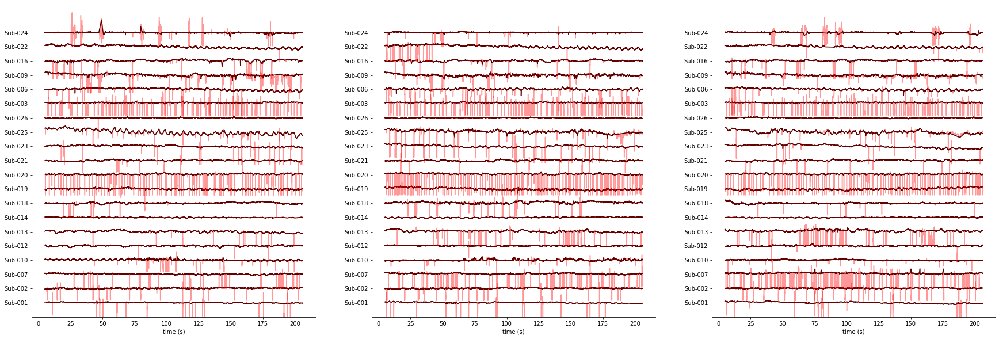

In [14]:
list_subs = list(runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))


for i, sub in enumerate(list_subs):
    rs = runs[sub]['Baseline']
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))

for a in ax:
    a.set(ylim = (-50, 1050), 
          yticks=np.arange(0, 1000, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(runs.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)


### 1.3 Plot single traces
- to identify runs that need to be adjusted
- adjustment based on non-bandpassfiltered and non-normalized data for better visualization of artifact detection


/Users/kenohagena/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


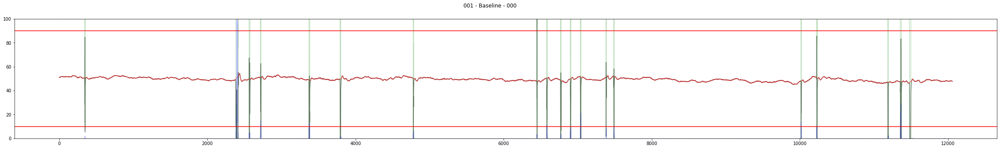

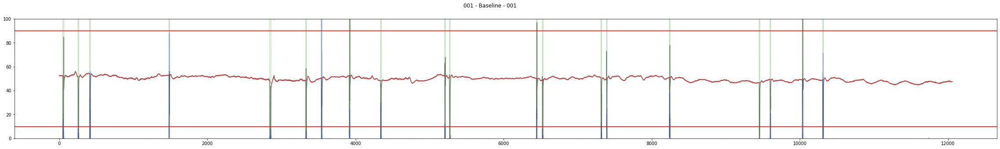

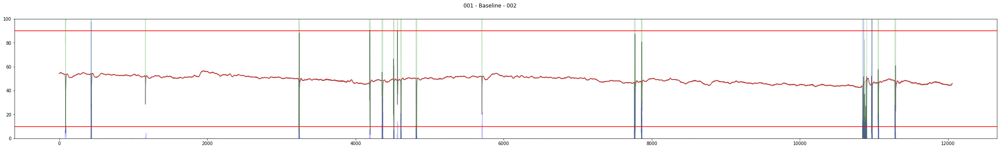

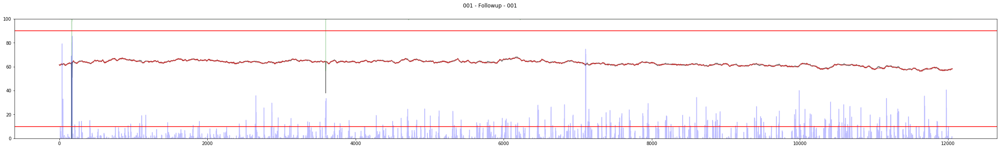

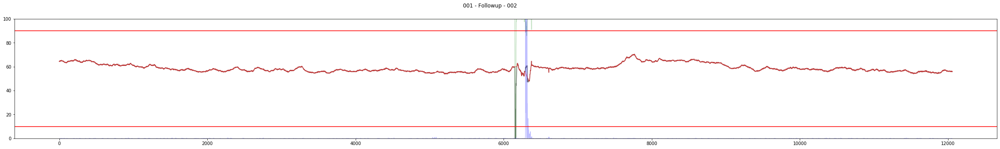

...

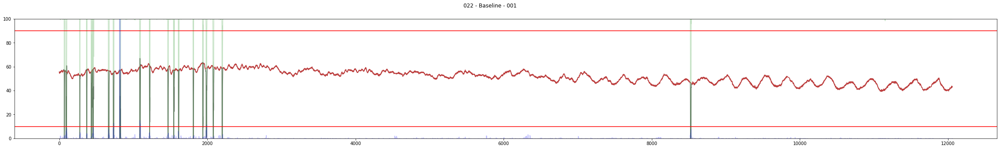

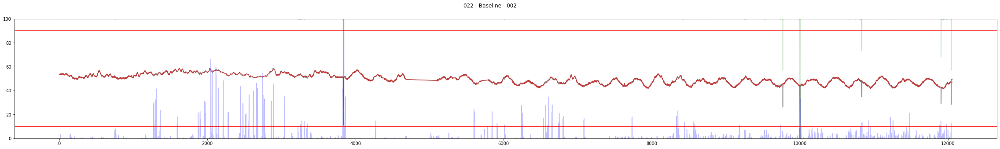

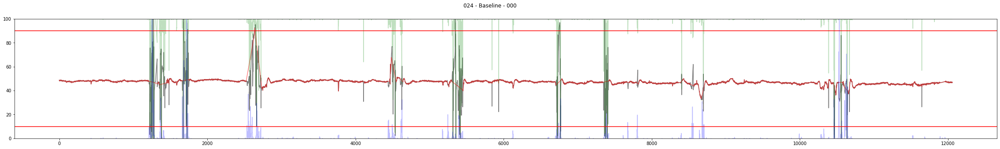

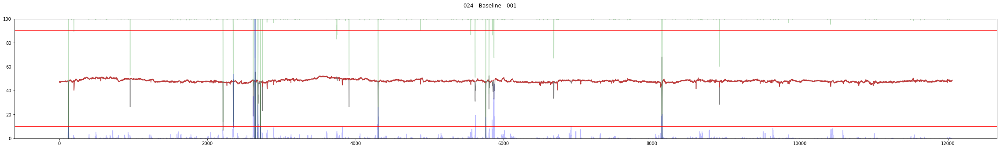

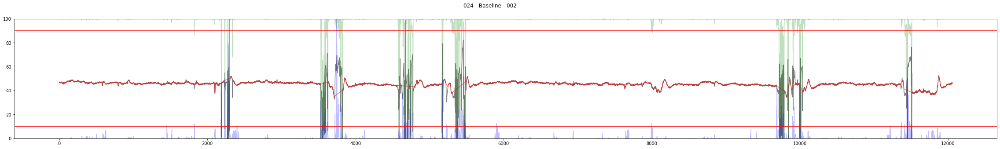

In [61]:
for sub, dic in runs.items():
    for session, lis in dic.items():
        if lis is None:
            continue
        else:
            for run in lis:
                d = pd.read_hdf(join(directory, 'Pupil_Preprocessed_SUB-{0}_{1}_{2}.hdf'.format(sub, session, run)))
                ut.plot_single_trace(d, sub = sub, session = session, run = run)
                
                


### 1.4 Adjust parameters for these participants
- for PSP: 7 Baseline, 20 Baseline, 16 Baseline, 24 Baseline

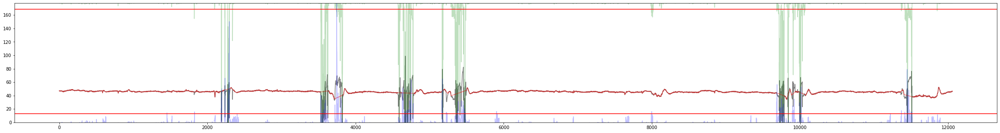

In [42]:
subject = '024'
session = 'Baseline'
rs = runs[subject][session]

a_islands = 10
a_excel_thresh = 2
a_confidence_thresh = .95
a_margin1 = 10
a_margin2 = 10

PS.adjust(subject, 'patient', session, rs[2], directory = '/Volumes/psp_data/PSP/',
         islands=a_islands, 
          excel_thresh=a_excel_thresh, 
          confidence_thresh = a_confidence_thresh,
            margin1 = a_margin1, margin2 = a_margin2,
         parameters = True)

In [43]:
# save adjusted parameters
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'islands'] = islands
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'excel_thresh'] = a_excel_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'confidence_thresh'] = a_confidence_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin1'] = a_margin1
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin2'] = a_margin2

pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session)]

,subject,session,run,islands,excel_thresh,confidence_thresh,margin1,margin2
87,024,Baseline,000,10,2,0.95,10,10
88,024,Baseline,001,10,2,0.95,10,10
89,024,Baseline,002,10,2,0.95,10,10


In [59]:
pp_params.to_hdf(join(directory, 'Meta', 'preprocessing_parameters_PSP.hdf'), key='data')

### 1.5 Run again with adjusted parameters and plot overview again
- now also bandpass

In [4]:
pp_params = pd.read_hdf(join(directory, 'Meta', 'preprocessing_parameters_PSP.hdf'), key='data')

In [6]:
for sub, dic in dt.runs.items():
    for session, lis in dic.items():
        if lis is None:
            print(sub, session, None)
        else:
            #print(sub, session)
            for run in lis:
                params = pp_params.loc[(pp_params.subject == sub)&(pp_params.session == session)&(pp_params.run == run)]
                pupil = PS.execute(sub, 'PSP', session, run, directory = '/Volumes/psp_data/PSP/', 
                                   islands=params.islands.values[0], excel_thresh=params.excel_thresh.values[0], 
                                   confidence_thresh = params.confidence_thresh.values[0],
                                  margin1 = params.margin1.values[0], margin2 = params.margin2.values[0], bandpass=True)



002 Followup None
013 Followup None
014 Followup None
021 Followup None
023 Followup None
025 Followup None
Confidence equal in both eyes
026 Followup None
Confidence equal in both eyes
Confidence equal in both eyes
009 Followup None
022 Followup None
024 Followup None


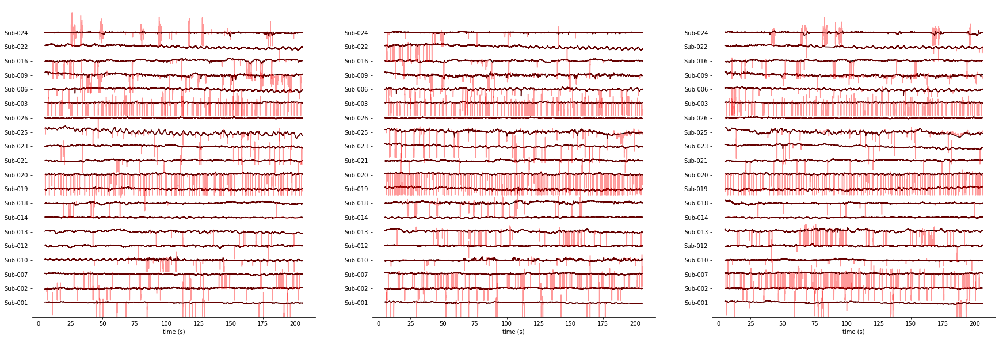

In [10]:
list_subs = list(dt.runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))


for i, sub in enumerate(list_subs):
    rs = dt.runs[sub]['Baseline']
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PSP', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))

for a in ax:
    a.set(ylim = (-50, 1050), 
          yticks=np.arange(0, 1000, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.runs.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)
f.savefig(join(directory, 'Meta', 'Preprocessing_PSP_Baseline.png'), dpi=600)

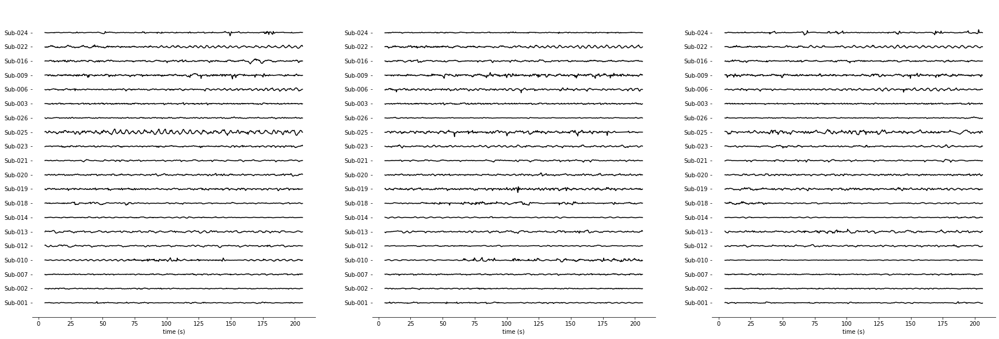

In [7]:
# for sanity check plot bandpassed filtered data

list_subs = list(dt.runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.runs[sub]['Baseline']
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PSP', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(data.d_intp_bp.values - data.d_intp_bp.mean() + i*50, color='black')
        except IndexError:
            print('no run for {}'.format(sub))

for a in ax:
    a.set(ylim = (-50, 1050), 
          yticks=np.arange(0, 1000, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.runs.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)
f.savefig(join(directory, 'Meta', 'Preprocessing_PSP_Baseline_bandpassed.png'), dpi=600)

## 2. Healthy Controls

### 2.1 Run on standard parameters

In [29]:
pp_params = []

for sub, runs in dt.c_runs_g.items():
    for run in runs:
        session = 'Baseline'
        pupil = PS.execute(sub, 'Control', session, run, directory = '/Volumes/psp_data/PSP/', 
                           islands=islands, excel_thresh=excel_thresh, confidence_thresh = confidence_thresh,
                          margin1 = margin1, margin2 = margin2)
        pp_params.append({'subject':sub,
              'session':session,
              'run':run,
              'islands':islands,
            'excel_thresh':excel_thresh,
            'confidence_thresh':confidence_thresh,
            'margin1':margin1,
            'margin2':margin2})

pp_params = pd.DataFrame(pp_params)

### 2.2 Plot overview

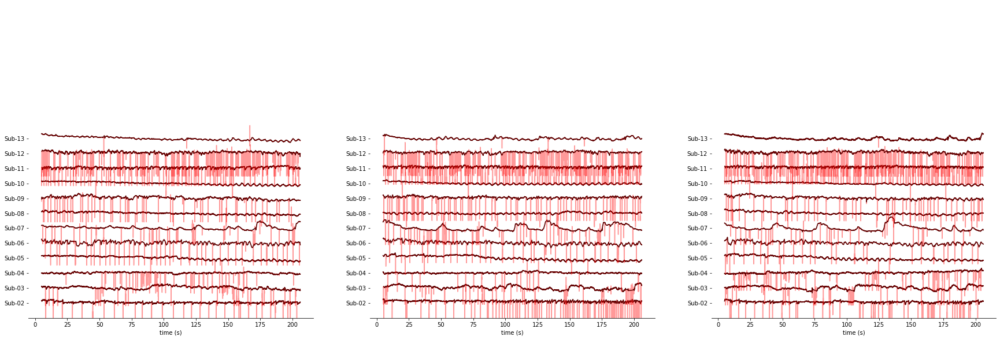

In [28]:
list_subs = list(dt.c_runs_g.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.c_runs_g[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Control', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

### 2.3 Plot single traces

/Users/kenohagena/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


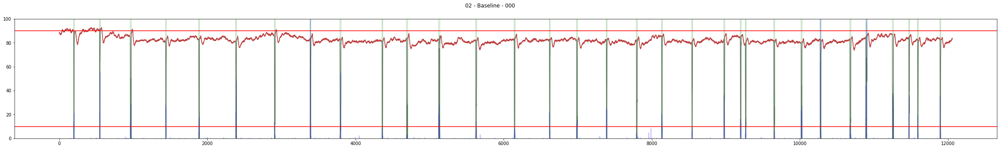

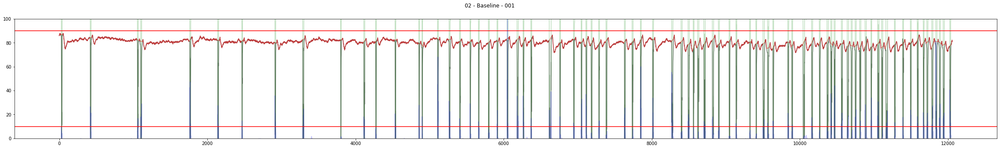

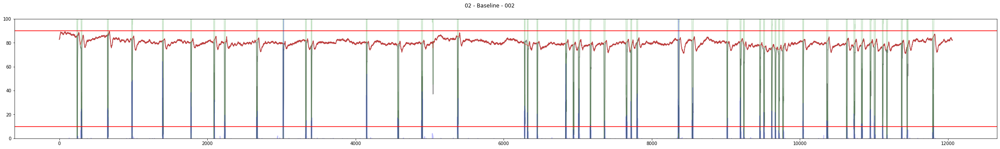

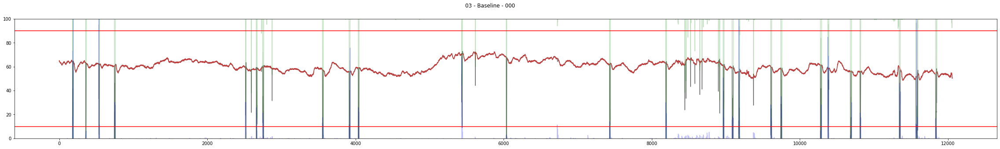

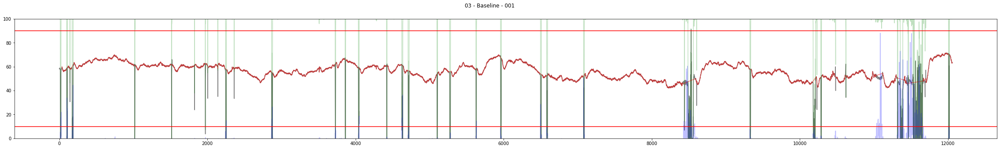

...

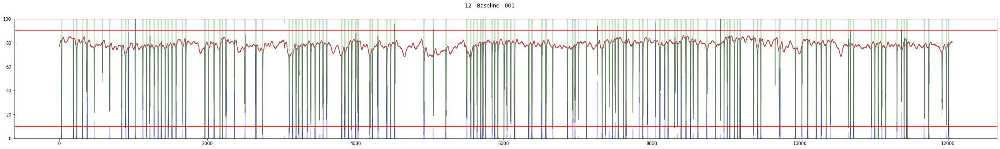

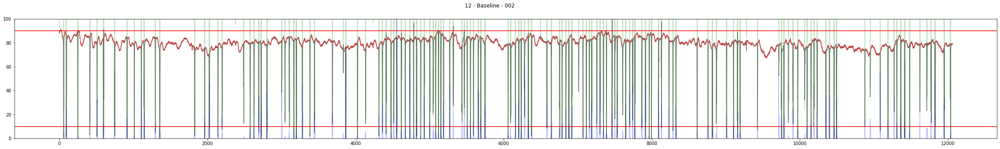

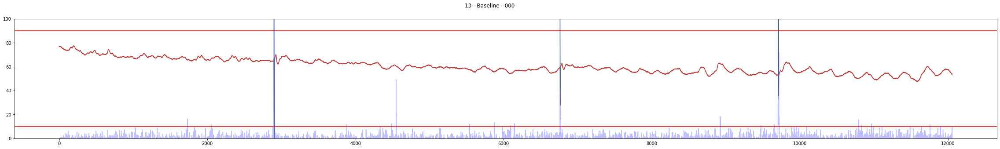

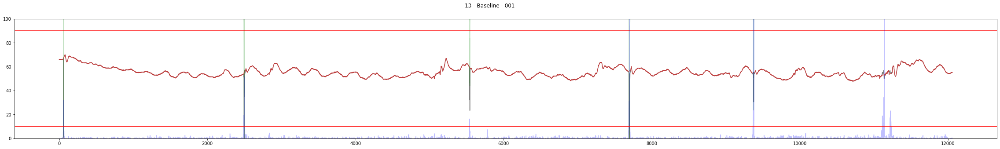

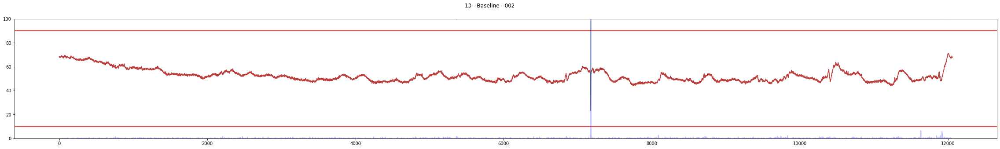

In [32]:
for sub, runs in dt.c_runs_g.items():
    for run in runs:
        d = pd.read_hdf(join(directory, 'Control', 'Pupil_Preprocessed_SUB-{0}_{1}_{2}.hdf'.format(sub, 'Baseline', run)))
        ut.plot_single_trace(d, sub = sub, session = session, run = run)
                

### 2.4 Adjust

/Volumes/psp_data/PSP/control/*K02/000/pupil_data


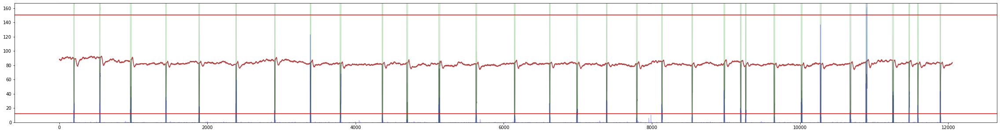

In [46]:
subject = '02'
session = 'Baseline'
rs = dt.c_runs_g[subject]

a_islands = 10
a_excel_thresh = 2
a_confidence_thresh = .9
a_margin1 = 10
a_margin2 = 10

PS.adjust(subject, 'Control', session, rs[0], directory = '/Volumes/psp_data/PSP/',
         islands=a_islands, 
          excel_thresh=a_excel_thresh, 
          confidence_thresh = a_confidence_thresh,
            margin1 = a_margin1, margin2 = a_margin2,
         parameters = True)

In [51]:
# save adjusted parameters
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'islands'] = a_islands
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'excel_thresh'] = a_excel_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'confidence_thresh'] = a_confidence_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin1'] = a_margin1
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin2'] = a_margin2

pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session)]

,subject,session,run,islands,excel_thresh,confidence_thresh,margin1,margin2
0,02,Baseline,000,10,2,0.9,10,10
1,02,Baseline,001,10,2,0.9,10,10
2,02,Baseline,002,10,2,0.9,10,10


In [52]:
pp_params.to_hdf(join(directory, 'Meta', 'preprocessing_parameters_Controls.hdf'), key='data')


### 2.5 Rerun with adjusted paraemters and plot overview again

In [11]:
pp_params = pd.read_hdf(join(directory, 'Meta', 'preprocessing_parameters_Controls.hdf'), key='data')

In [12]:
for sub, runs in dt.c_runs_g.items():
    for run in runs:
        session = 'Baseline'
        params = pp_params.loc[(pp_params.subject == sub)&(pp_params.session == session)&(pp_params.run == run)]
        pupil = PS.execute(sub, 'Control', session, run, directory = '/Volumes/psp_data/PSP/', 
                                   islands=params.islands.values[0], excel_thresh=params.excel_thresh.values[0], 
                                   confidence_thresh = params.confidence_thresh.values[0],
                                  margin1 = params.margin1.values[0], margin2 = params.margin2.values[0],
                          bandpass=True)

Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes


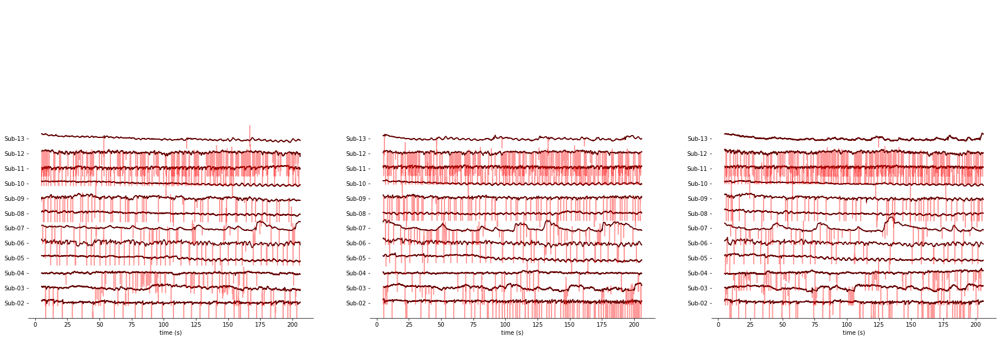

In [14]:
list_subs = list(dt.c_runs_g.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.c_runs_g[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Control', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_Control.png'), dpi=600)

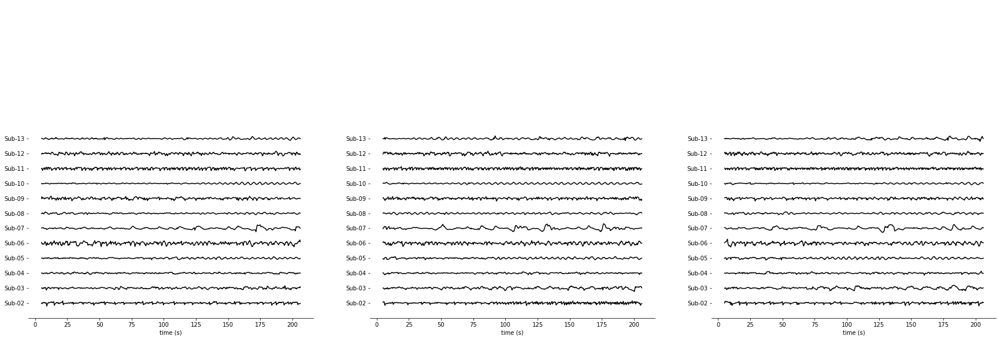

In [11]:
list_subs = list(dt.c_runs_g.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.c_runs_g[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Control', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            ax[j].plot(data.d_intp_bp.values - data.d_intp_bp.values.mean() + i*50, color='black')
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_Control_bandpassed.png'), dpi=600)

## 3. PD patients

### 3.1 Run on standard parameters

In [4]:
pp_params = []

for sub, runs in dt.ips_runs.items():
    for run in runs:
        session = 'Baseline'
        pupil = PS.execute(sub, 'PD', session, run, directory = '/Volumes/psp_data/PSP/', 
                           islands=islands, excel_thresh=excel_thresh, confidence_thresh = confidence_thresh,
                          margin1 = margin1, margin2 = margin2)
        pp_params.append({'subject':sub,
              'session':session,
              'run':run,
              'islands':islands,
            'excel_thresh':excel_thresh,
            'confidence_thresh':confidence_thresh,
            'margin1':margin1,
            'margin2':margin2})

pp_params = pd.DataFrame(pp_params)

Confidence equal in both eyes


### 3.2. Plot Overview

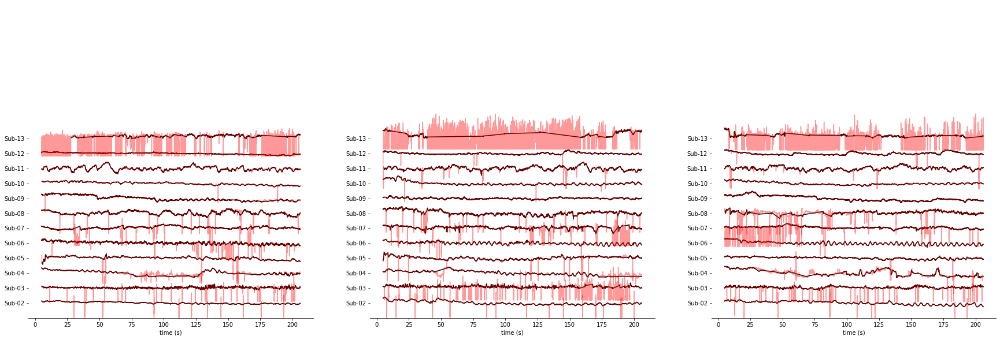

In [8]:
list_subs = list(dt.ips_runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.ips_runs[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PD', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

### 3.3 Plot single traces

/Users/kenohagena/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


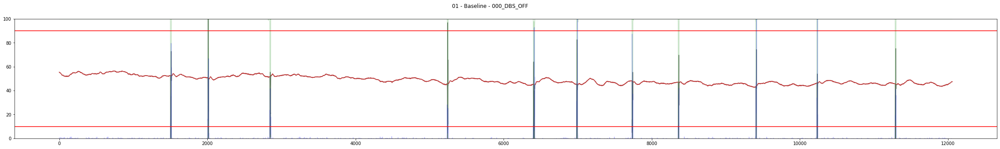

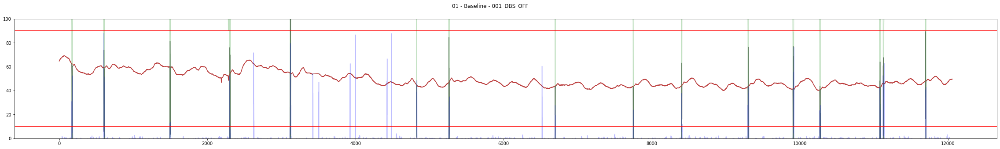

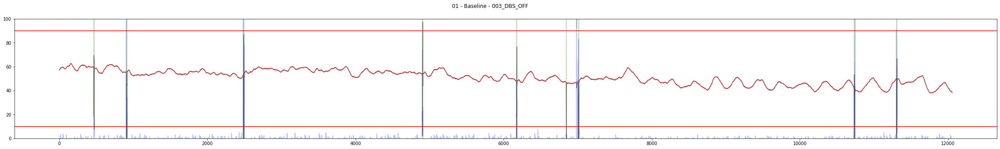

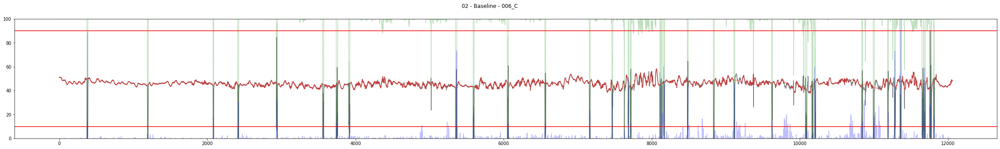

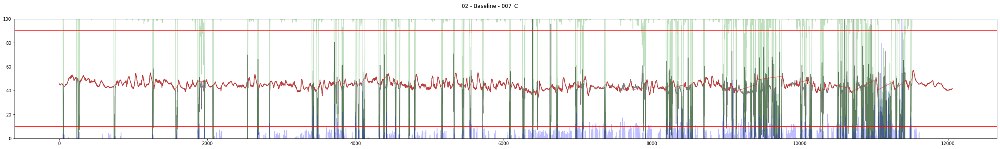

...

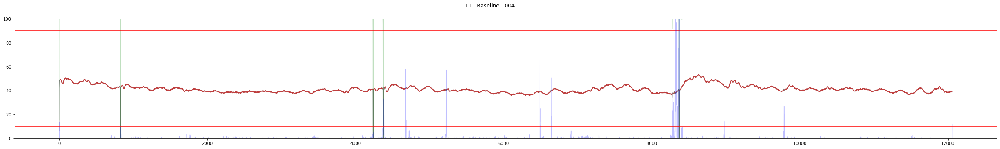

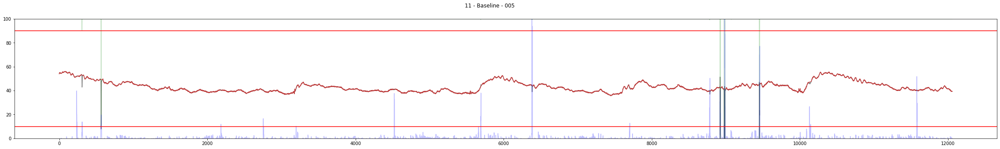

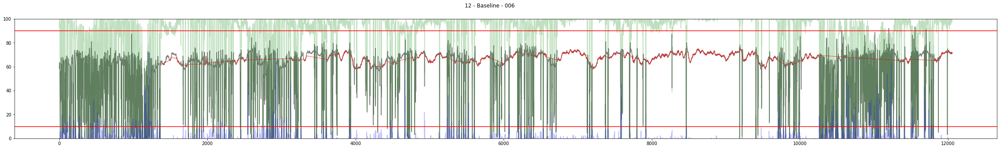

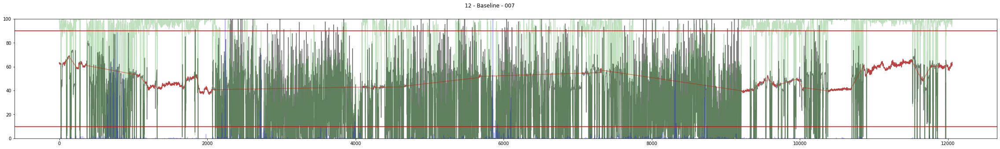

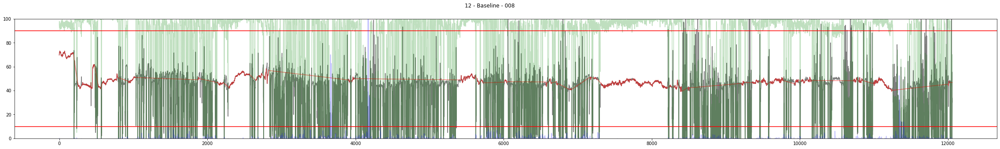

In [9]:
for sub, runs in dt.ips_runs.items():
    for run in runs:
        d = pd.read_hdf(join(directory, 'PD', 'Pupil_Preprocessed_SUB-{0}_{1}_{2}.hdf'.format(sub, 'Baseline', run)))
        ut.plot_single_trace(d, sub = sub, session = session, run = run)

### 3.4 Adjust parameters
-> adjust 3, 7, 8, 9

-> exclude Subject 12

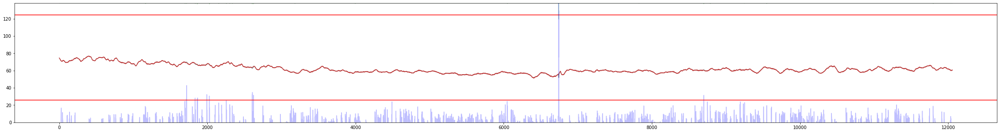

In [40]:
subject = '09'
session = 'Baseline'
rs = dt.ips_runs[subject]

a_islands = 10
a_excel_thresh = 5
a_confidence_thresh = .9
a_margin1 = 10
a_margin2 = 10

PS.adjust(subject, 'PD', session, rs[2], directory = '/Volumes/psp_data/PSP/',
         islands=a_islands, 
          excel_thresh=a_excel_thresh, 
          confidence_thresh = a_confidence_thresh,
            margin1 = a_margin1, margin2 = a_margin2,
         parameters = True)

In [41]:
# save adjusted parameters
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'islands'] = a_islands
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'excel_thresh'] = a_excel_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'confidence_thresh'] = a_confidence_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin1'] = a_margin1
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin2'] = a_margin2

pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session)]

,subject,session,run,islands,excel_thresh,confidence_thresh,margin1,margin2
24,09,Baseline,006,10,5,0.9,10,10
25,09,Baseline,007,10,5,0.9,10,10
26,09,Baseline,008,10,5,0.9,10,10


In [42]:
pp_params.to_hdf(join(directory, 'Meta', 'preprocessing_parameters_PD.hdf'), key='data')

### 3.5 Rerun on adjusted parameters and plot

In [15]:
pp_params = pd.read_hdf(join(directory, 'Meta', 'preprocessing_parameters_PD.hdf'), key='data')

In [16]:
for sub, runs in dt.ips_runs.items():
    for run in runs:
        session = 'Baseline'
        params = pp_params.loc[(pp_params.subject == sub)&(pp_params.session == session)&(pp_params.run == run)]
        pupil = PS.execute(sub, 'PD', session, run, directory = '/Volumes/psp_data/PSP/', 
                                   islands=params.islands.values[0], excel_thresh=params.excel_thresh.values[0], 
                                   confidence_thresh = params.confidence_thresh.values[0],
                                  margin1 = params.margin1.values[0], margin2 = params.margin2.values[0],
                          bandpass=True)

Confidence equal in both eyes


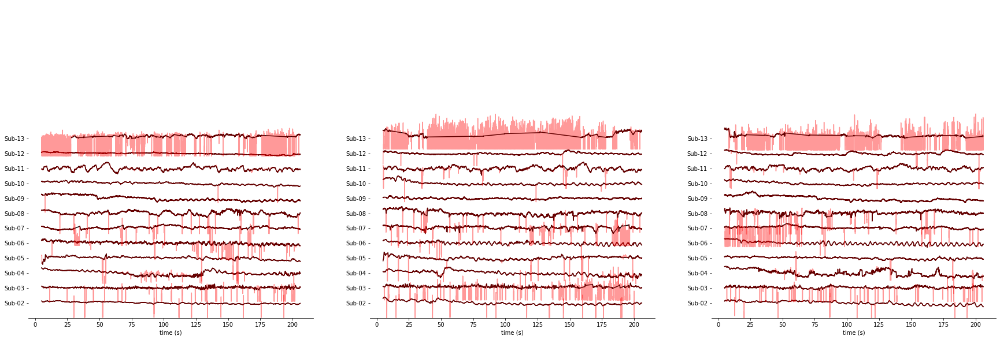

In [17]:
list_subs = list(dt.ips_runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.ips_runs[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PD', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_PD.png'), dpi=600)

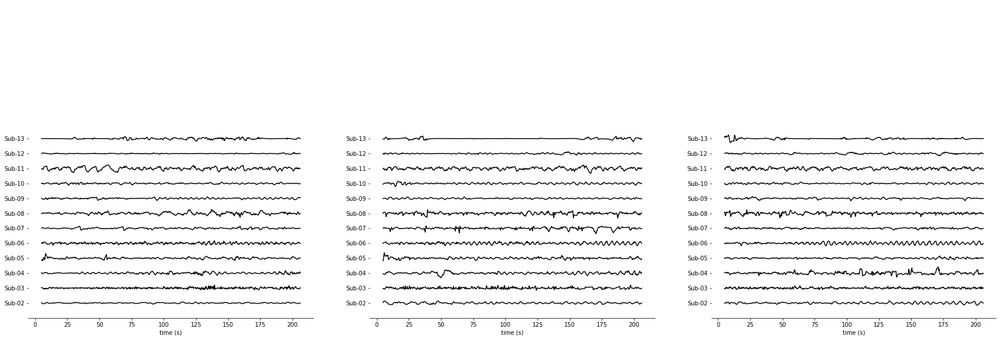

In [15]:
list_subs = list(dt.ips_runs.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.ips_runs[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PD', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            ax[j].plot(data.d_intp_bp.values - data.d_intp_bp.mean() + i*50, color='black')
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_g.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_PD_bandpassed.png'), dpi=600)

# B) Preprocessing Mollys Data
## 4. PSP old format 

## 5. PSP new format

In [18]:
@cached
def execute(subject, run, group= 'PSP_Molly', excel_thresh=2, confidence_thresh=.9, islands=10, margin1=10, margin2=10, bandpass=False):
    if group == 'PSP_Molly':
        file = glob(join('/Volumes/psp_data/PSP/data/raw/Data/sub-PSP_{0}/ses-S001/RAW_Streams/ses-S001'.format(subject), 
                             'sub-PSP_{0}_ses-S001_task-rest_*_run-{1}_eeg.xdf'.format(subject, run)))
    elif group == 'Control_Molly':
        file = glob(join('/Volumes/psp_data/PSP/data/raw/Data/sub-HC_{0}/ses-S001/RAW_Streams/ses-S001'.format(subject), 
                             'sub-HC_{0}_ses-S001_task-rest_*_run-{1}_eeg.xdf'.format(subject, run)))
    pupil = PS.PupilFrame(subject, group, 'Baseline', run, directory = '/Volumes/psp_data/PSP/', version= 'new')
    pupil.pupil['left'], pupil.pupil['right'], pupil.pupil['gaze'] = ut.load_xdf(file[0])
    pupil.cut_resample(start=5, end=210)
    pupil.excel()
    pupil.discard_interp(excel_thresh=excel_thresh, confidence_thresh=confidence_thresh,
                         islands=islands, margin2=margin2, margin1=margin1)
    if bandpass is True:
        pupil.bandpass()
    pupil.normalize(bandpass=bandpass)
    pupil.save()

In [38]:
pp_params = []
for subject, di in dt.runs_new_2.items():
    for run in di['Baseline']:
        execute(subject, run)
                
        pp_params.append({'subject':subject,
              'session':'Baseline',
              'run':run,
              'islands':islands,
            'excel_thresh':excel_thresh,
            'confidence_thresh':confidence_thresh,
            'margin1':margin1,
            'margin2':margin2})

pp_params = pd.DataFrame(pp_params)

Confidence equal in both eyes
Confidence equal in both eyes


### 5.2 Plot single traces

/Users/kenohagena/Documents/Forschung/PSP/src/module/PSPupil/utils.py:60: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax = plt.subplots(figsize=(40, 5))


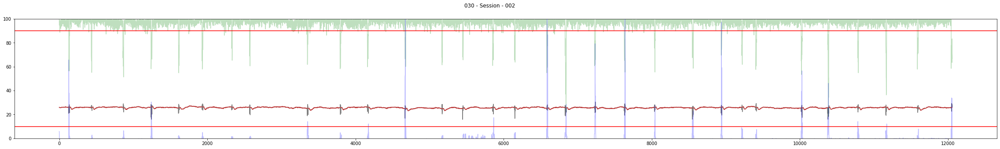

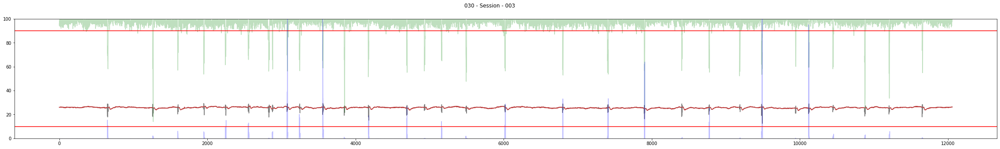

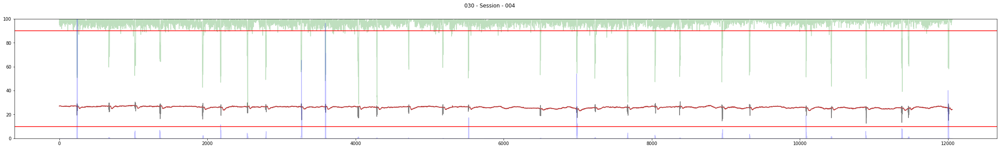

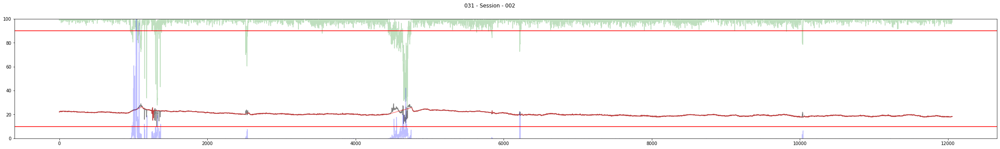

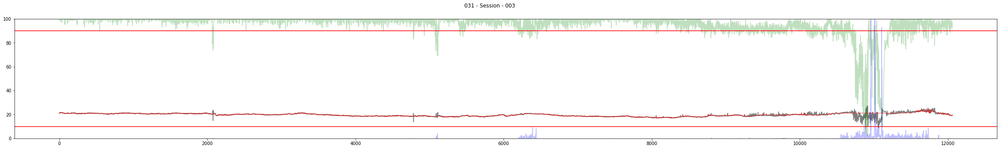

...

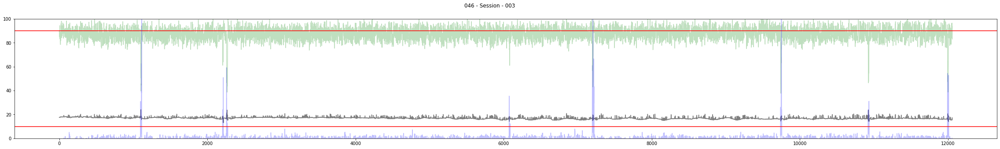

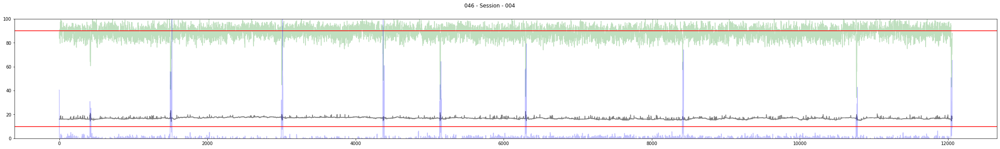

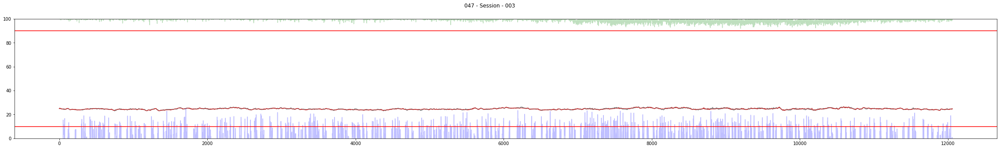

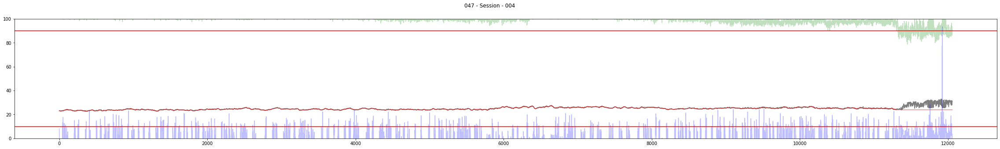

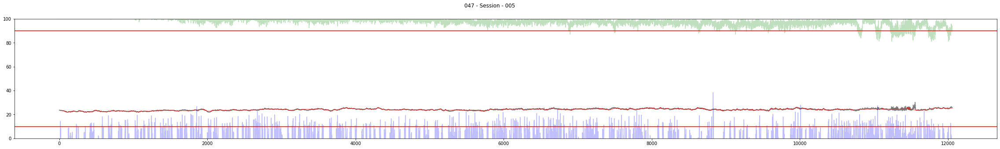

In [4]:
for sub, runs in dt.runs_new_2.items():
    for run in runs['Baseline']:
        d = pd.read_hdf(join(directory, 'PSP_Molly', 'Pupil_Preprocessed_SUB-{0}_{1}_{2}.hdf'.format(sub, 'Baseline', run)))
        ut.plot_single_trace(d, sub = sub, run = run)

### 5.3 Adjust parameters

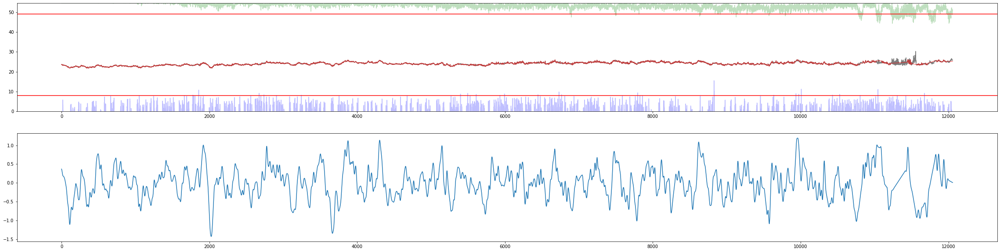

In [89]:
subject = '047'
session = 'Baseline'
rs = dt.runs_new_2[subject][session]
run = rs[2]
a_islands = 10
a_excel_thresh = 4
a_confidence_thresh = .9
a_margin1 = 10
a_margin2 = 10



file = glob(join('/Volumes/psp_data/PSP/data/raw/Data/sub-PSP_{0}/ses-S001/RAW_Streams/ses-S001'.format(subject), 
                         'sub-PSP_{0}_ses-S001_task-rest_*_run-{1}_eeg.xdf'.format(subject, run)))
pupil = PS.PupilFrame(subject, 'PSP_Molly', 'Baseline', run, directory = '/Volumes/psp_data/PSP/', version= 'new')
pupil.pupil['left'], pupil.pupil['right'], pupil.pupil['gaze'] = ut.load_xdf(file[0])
pupil.cut_resample(start=5, end=210)
pupil.excel()
pupil.discard_interp(excel_thresh=a_excel_thresh, confidence_thresh=a_confidence_thresh,
                     islands=a_islands, margin2=a_margin2, margin1=a_margin1)
pupil.bandpass()
pupil.normalize()


f, ax = plt.subplots(2, 1, figsize=(40, 10))
ax[0].plot(pupil.gp.diameter_mean.values, color='black', alpha=.5)
ax[0].plot(pupil.gp.d_intp.values, color='red', alpha=.5)

m = pupil.gp.diameter_mean.max()
ax[0].plot(pupil.gp.confidence_d.values*m*1.8, color='green', alpha=.25)
ax[0].axhline(a_confidence_thresh*m*1.8, color='red')
ax[0].plot(pupil.gp.acceleration.values*m/15, color='blue', alpha=.25)
ax[0].axhline(a_excel_thresh*m/15, color='red')
ax[0].set_ylim(0, m*1.8)

ax[1].plot(pupil.gp.d_intp_bp.values)

In [90]:
# save adjusted parameters
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'islands'] = a_islands
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'excel_thresh'] = a_excel_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'confidence_thresh'] = a_confidence_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin1'] = a_margin1
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin2'] = a_margin2

pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session)]

,subject,session,run,islands,excel_thresh,confidence_thresh,margin1,margin2
39,047,Baseline,003,10,4,0.9,10,10
40,047,Baseline,004,10,4,0.9,10,10
41,047,Baseline,005,10,4,0.9,10,10


- exclude subject 34

In [91]:
pp_params.to_hdf(join(directory, 'Meta', 'preprocessing_parameters_PSP_Molly.hdf'), key='data')

### 5.4 Rerun on adjusted parameters and plot overview

In [19]:
pp_params = pd.read_hdf(join(directory, 'Meta', 'preprocessing_parameters_PSP_Molly.hdf'), key='data')
session = 'Baseline'
for sub, runs in dt.runs_new_2.items():
    for run in runs[session]:
        params = pp_params.loc[(pp_params.subject == sub)&(pp_params.session == session)&(pp_params.run == run)]
        execute(sub, run, islands=params.islands.values[0], excel_thresh=params.excel_thresh.values[0], 
                                   confidence_thresh = params.confidence_thresh.values[0],
                                  margin1 = params.margin1.values[0], margin2 = params.margin2.values[0],
                          bandpass=True)
        


Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes


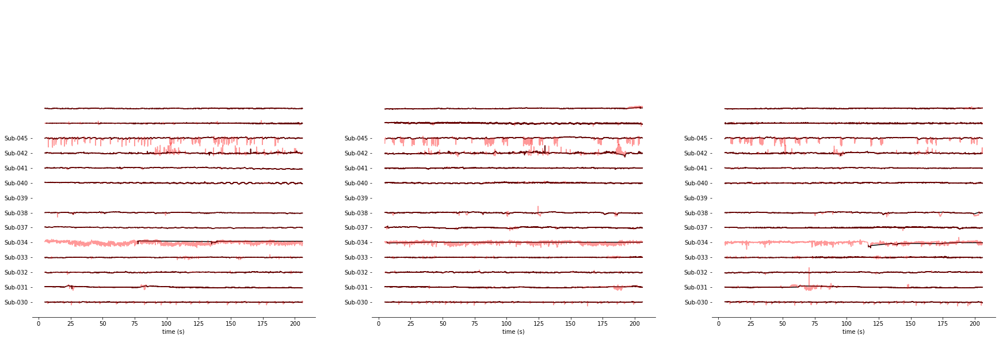

In [20]:
list_subs = list(dt.runs_new_2.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.runs_new_2[sub]['Baseline']
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PSP_Molly', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.runs_new_2.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_PSP_Molly.png'), dpi=600)

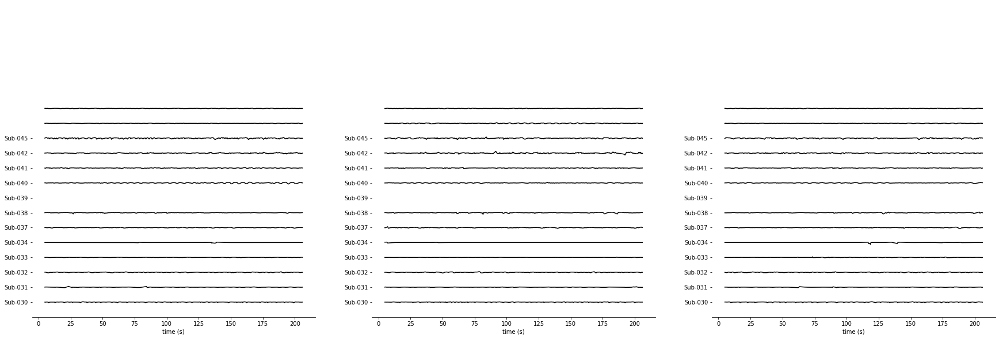

In [94]:
list_subs = list(dt.runs_new_2.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.runs_new_2[sub]['Baseline']
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'PSP_Molly', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            ax[j].plot(data.d_intp_bp.values - data.d_intp_bp.mean() + i*50, color='black')
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.runs_new_2.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_PSP_Molly_bandpassed.png'), dpi=600)

### Summary: 
- Exclude subject 34 (too much noise)
- Subject 39 currently data problem (aparently no right pupil, etc.)

## 6. New Controls (Mollys data)

In [11]:
pp_params = []
for subject, di in dt.c_runs_m.items():
    for run in di:
        execute(subject, run, group='Control_Molly', confidence_thresh=.8)
                
        pp_params.append({'subject':subject,
              'session':'Baseline',
              'run':run,
              'islands':islands,
            'excel_thresh':excel_thresh,
            'confidence_thresh':0.8,
            'margin1':margin1,
            'margin2':margin2})

pp_params = pd.DataFrame(pp_params)

Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes


### 6.2 Plot single traces

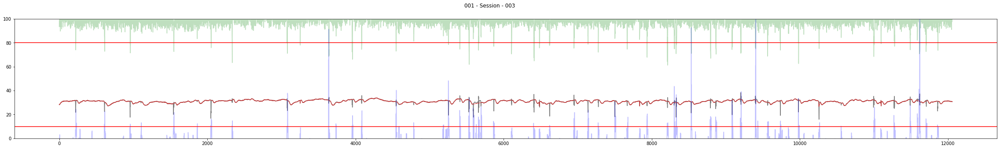

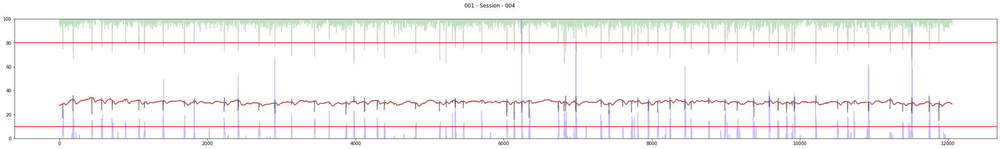

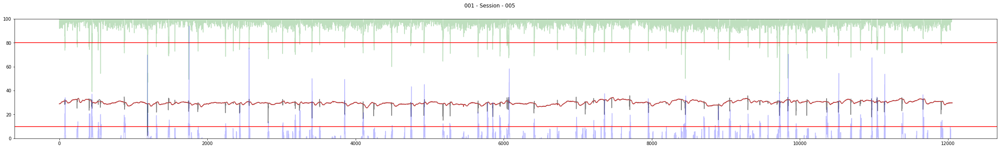

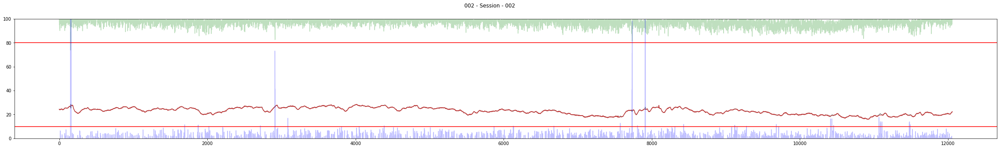

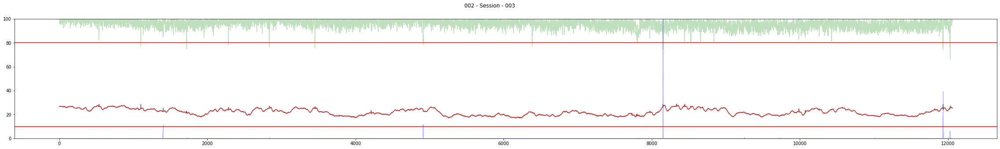

...

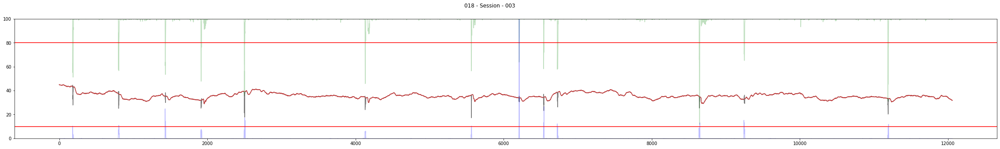

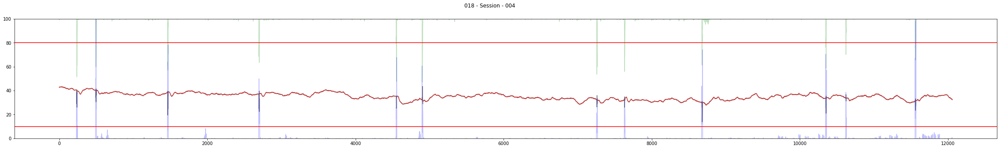

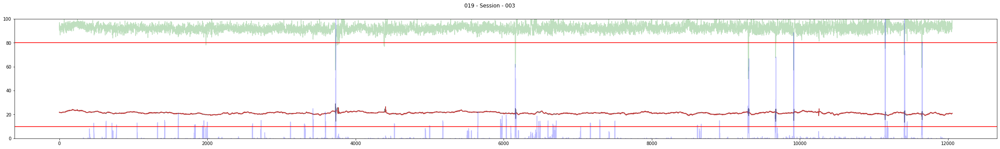

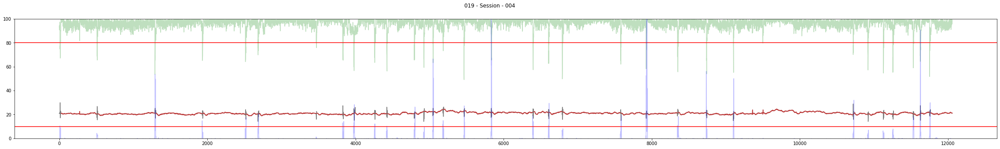

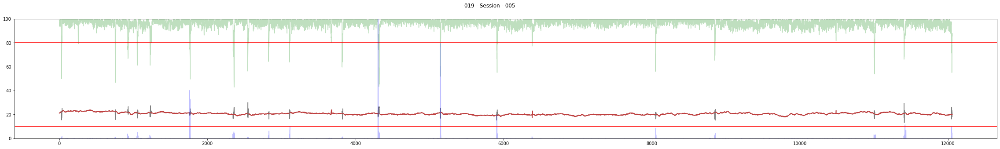

In [12]:
for sub, runs in dt.c_runs_m.items():
    for run in runs:
        d = pd.read_hdf(join(directory, 'Control_Molly', 'Pupil_Preprocessed_SUB-{0}_{1}_{2}.hdf'.format(sub, 'Baseline', run)))
        ut.plot_single_trace(d, sub = sub, run = run, confidence_thresh=.8)

### 6.3 ADjust parameters

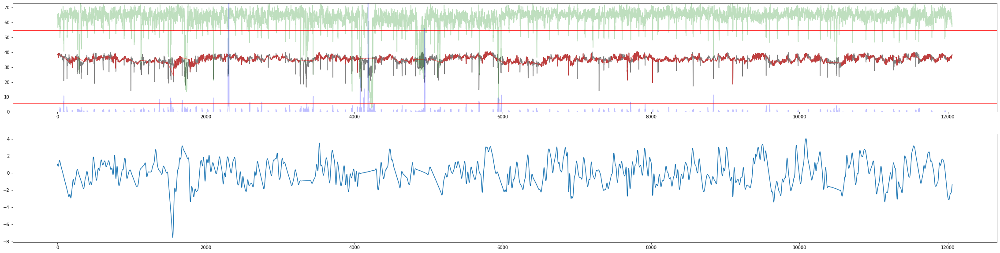

In [34]:
subject = '009'
session = 'Baseline'
rs = dt.c_runs_m[subject]
run = rs[2]
a_islands = 10
a_excel_thresh = 2
a_confidence_thresh = .75
a_margin1 = 10
a_margin2 = 30



file = glob(join('/Volumes/psp_data/PSP/data/raw/Data/sub-HC_{0}/ses-S001/RAW_Streams/ses-S001'.format(subject), 
                         'sub-HC_{0}_ses-S001_task-rest_*_run-{1}_eeg.xdf'.format(subject, run)))
pupil = PS.PupilFrame(subject, 'Control_Molly', 'Baseline', run, directory = '/Volumes/psp_data/PSP/', version= 'new')
pupil.pupil['left'], pupil.pupil['right'], pupil.pupil['gaze'] = ut.load_xdf(file[0])
pupil.cut_resample(start=5, end=210)
pupil.excel()
pupil.discard_interp(excel_thresh=a_excel_thresh, confidence_thresh=a_confidence_thresh,
                     islands=a_islands, margin2=a_margin2, margin1=a_margin1)
pupil.bandpass()
pupil.normalize()


f, ax = plt.subplots(2, 1, figsize=(40, 10))
ax[0].plot(pupil.gp.diameter_mean.values, color='black', alpha=.5)
ax[0].plot(pupil.gp.d_intp.values, color='red', alpha=.5)

m = pupil.gp.diameter_mean.max()
ax[0].plot(pupil.gp.confidence_d.values*m*1.8, color='green', alpha=.25)
ax[0].axhline(a_confidence_thresh*m*1.8, color='red')
ax[0].plot(pupil.gp.acceleration.values*m/15, color='blue', alpha=.25)
ax[0].axhline(a_excel_thresh*m/15, color='red')
ax[0].set_ylim(0, m*1.8)

ax[1].plot(pupil.gp.d_intp_bp.values)

In [35]:
# save adjusted parameters
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'islands'] = a_islands
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'excel_thresh'] = a_excel_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'confidence_thresh'] = a_confidence_thresh
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin1'] = a_margin1
pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session), 'margin2'] = a_margin2

pp_params.loc[(pp_params.subject == subject)&(pp_params.session == session)]

,subject,session,run,islands,excel_thresh,confidence_thresh,margin1,margin2
24,009,Baseline,002,10,2,0.75,10,30
25,009,Baseline,003,10,2,0.75,10,30
26,009,Baseline,004,10,2,0.75,10,30


In [36]:
pp_params.to_hdf(join(directory, 'Meta', 'preprocessing_parameters_PSP_Molly.hdf'), key='data')

Subjects 3 and 6 with bad data quality, no exclusion

### 5.4 Rerun on adjusted parameters and plot overview

In [21]:
pp_params = pd.read_hdf(join(directory, 'Meta', 'preprocessing_parameters_Control_Molly.hdf'), key='data')
session = 'Baseline'
for sub, runs in dt.c_runs_m.items():
    for run in runs:
        params = pp_params.loc[(pp_params.subject == sub)&(pp_params.session == session)&(pp_params.run == run)]
        execute(sub, run, group='Control_Molly', islands=params.islands.values[0], excel_thresh=params.excel_thresh.values[0], 
                                   confidence_thresh = params.confidence_thresh.values[0],
                                  margin1 = params.margin1.values[0], margin2 = params.margin2.values[0],
                          bandpass=True)
        

Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes
Confidence equal in both eyes


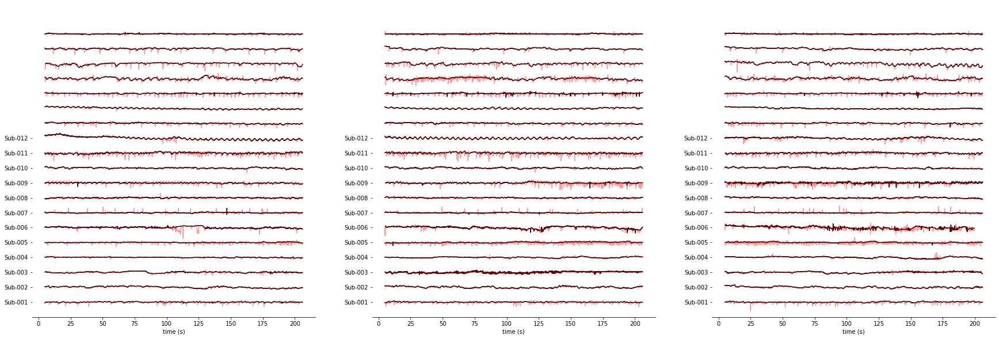

In [22]:
list_subs = list(dt.c_runs_m.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.c_runs_m[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Control_Molly', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            orig = data.diameter_mean.values
            d_intp = data.d_intp.values
            ax[j].plot(d_intp - orig.mean() + i*50, color='black')
            ax[j].plot(orig - orig.mean() + i*50, color='red', alpha=.4)
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_m.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_Control_Molly.png'), dpi=600)

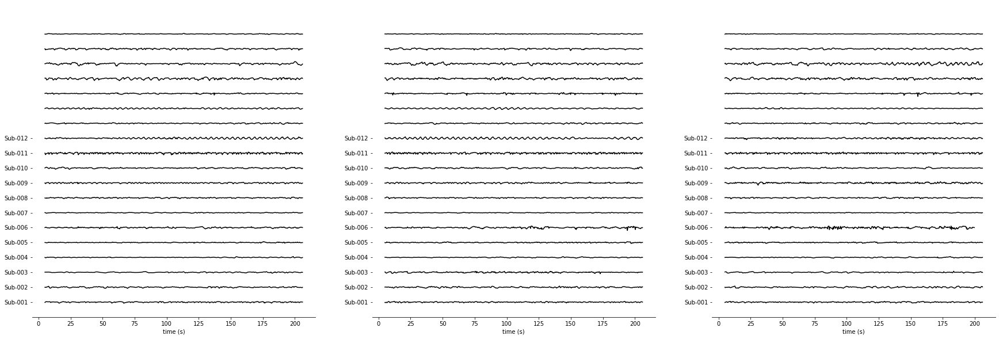

In [101]:
list_subs = list(dt.c_runs_m.keys())
f, ax = plt.subplots(1, 3, figsize=(30, 10))

for i, sub in enumerate(list_subs):
    rs = dt.c_runs_m[sub]
    for j in range(3):
        try:
            data = pd.read_hdf(join(directory, 'Control_Molly', 'Pupil_Preprocessed_SUB-{0}_Baseline_{1}.hdf'.format(sub, rs[j])))
            ax[j].plot(data.d_intp_bp.values - data.d_intp_bp.mean() + i*50, color='black')
        except IndexError:
            print('no run for {}'.format(sub))
    
for a in ax:
    a.set(ylim = (-50, 1000), 
          yticks=np.arange(0, 600, 50), 
          yticklabels=['Sub-{}'.format(i) for i in list(dt.c_runs_m.keys())],
          xticks = np.arange(-5, 210, 25)*60, 
          xticklabels=np.arange(0, 205, 25), 
          xlabel='time (s)')

sns.despine(left=True)

f.savefig(join(directory, 'Meta', 'Preprocessing_Control_Molly_bandpassed.png'), dpi=600)